In [19]:
import pandas as pd
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns
import os
from causallearn.search.ConstraintBased.FCI import fci
from causallearn.search.ConstraintBased.PC import pc
from causallearn.utils.GraphUtils import GraphUtils

In [20]:
dtype_dict = {
    "HBSC": "float64",
    "seqno_int": "float64",
    "cluster": "float64",
    "countryno": "float64",
    "region": "string",
    "id1": "float64",
    "id2": "float64",
    "id3": "float64",
    "id4": "float64",
    "weight": "float64",
    "adm": "float64",
    "month": "float64",
    "year": "float64",
    "age": "float64",
    "agecat": "float64",
    "sex": "float64",
    "grade": "float64",
    "monthbirth": "float64",
    "yearbirth": "float64",
    "fasfamcar": "float64",
    "fasbedroom": "float64",
    "fascomputers": "float64",
    "fasbathroom": "float64",
    "fasdishwash": "float64",
    "fasholidays": "float64",
    "health": "float64",
    "lifesat": "float64",
    "headache": "float64",
    "stomachache": "float64",
    "backache": "float64",
    "feellow": "float64",
    "irritable": "float64",
    "nervous": "float64",
    "sleepdificulty": "float64",
    "dizzy": "float64",
    "thinkbody": "float64",
    "physact60": "float64",
    "breakfastwd": "float64",
    "breakfastwe": "float64",
    "fruits_2": "float64",
    "vegetables_2": "float64",
    "sweets_2": "float64",
    "softdrinks_2": "float64",
    "fmeal": "float64",
    "toothbr": "float64",
    "timeexe": "float64",
    "smokltm": "float64",
    "smok30d_2": "float64",
    "alcltm": "float64",
    "alc30d_2": "float64",
    "drunkltm": "float64",
    "drunk30d": "float64",
    "cannabisltm_2": "float64",
    "cannabis30d_2": "float64",
    "bodyweight": "float64",
    "bodyheight": "float64",
    "likeschool": "float64",
    "schoolpressure": "float64",
    "studtogether": "float64",
    "studhelpful": "float64",
    "studaccept": "float64",
    "teacheraccept": "float64",
    "teachercare": "float64",
    "teachertrust": "float64",
    "bulliedothers": "float64",
    "beenbullied": "float64",
    "cbulliedothers": "float64",
    "cbeenbullied": "float64",
    "fight12m": "float64",
    "injured12m": "float64",
    "friendhelp": "float64",
    "friendcounton": "float64",
    "friendshare": "float64",
    "friendtalk": "float64",
    "emconlfreq1": "float64",
    "emconlfreq2": "float64",
    "emconlfreq3": "float64",
    "emconlfreq4": "float64",
    "emconlpref1": "float64",
    "emconlpref2": "float64",
    "emconlpref3": "float64",
    "emcsocmed1": "float64",
    "emcsocmed2": "float64",
    "emcsocmed3": "float64",
    "emcsocmed4": "float64",
    "emcsocmed5": "float64",
    "emcsocmed6": "float64",
    "emcsocmed7": "float64",
    "emcsocmed8": "float64",
    "emcsocmed9": "float64",
    "hadsex": "float64",
    "agesex": "float64",
    "contraceptcondom": "float64",
    "contraceptpill": "float64",
    "countryborn": "string",
    "countrybornmo": "string",
    "countrybornfa": "string",
    "motherhome1": "float64",
    "fatherhome1": "float64",
    "stepmohome1": "float64",
    "stepfahome1": "float64",
    "fosterhome1": "float64",
    "elsehome1_2": "float64",
    "employfa": "float64",
    "employmo": "float64",
    "employnotfa": "float64",
    "employnotmo": "float64",
    "talkfather": "float64",
    "talkstepfa": "float64",
    "talkmother": "float64",
    "talkstepmo": "float64",
    "famhelp": "float64",
    "famsup": "float64",
    "famtalk": "float64",
    "famdec": "float64",
    "MBMI": "float64",
    "IRFAS": "float64",
    "IRRELFAS_LMH": "float64",
    "IOTF4": "float64",
    "oweight_who": "float64"
}




In [21]:
data = pd.read_csv("HBSC/HBSC2018OAed1.1.csv",
                   delimiter=";",
                   dtype = dtype_dict,
                   skipinitialspace=True,
                    decimal=',')


In [22]:
retain = ["sex", "agecat", "IRFAS",
          #"IRRELFAS_LMH",
          "IOTF4",         "emcsocmed1", "emcsocmed2", "emcsocmed3", "emcsocmed4", "emcsocmed5", "emcsocmed6", "emcsocmed7", "emcsocmed8", "emcsocmed9",         "likeschool", "schoolpressure", "studtogether", "studhelpful", "studaccept",
        "teacheraccept", "teachercare", "teachertrust",        "bulliedothers", "beenbullied", "cbulliedothers", "cbeenbullied", "fight12m", "injured12m",        "emconlfreq1", "emconlfreq2", "emconlfreq3", "emconlfreq4",
        "emconlpref1", "emconlpref2", "emconlpref3",        "friendhelp", "friendcounton", "friendshare", "friendtalk", "famhelp", "famsup", "famtalk", "famdec",
        "talkfather", "talkstepfa", "talkmother", "talkstepmo", "timeexe",        "health", "lifesat", "headache", "stomachache", "backache", "feellow", "irritable", "nervous",
        "sleepdificulty", "dizzy", "thinkbody","motherhome1", "fatherhome1", "stepmohome1", "stepfahome1", "fosterhome1", "elsehome1_2",
        "employfa", "employmo", "employnotfa", "employnotmo"]

retain_dict = {
    "demographics": [
        "sex", "agecat"
    ],
    "family_affluence_indices": [
        "IRFAS", #"IRRELFAS_LMH"
    ],
    "anthropometric_indices": [
        "IOTF4"
    ],
    "digital_communication": [
        "emcsocmed1", "emcsocmed2", "emcsocmed3", "emcsocmed4", "emcsocmed5", "emcsocmed6", "emcsocmed7", "emcsocmed8", "emcsocmed9"
    ],
    "school_environment": [
        "likeschool", "schoolpressure", "studtogether", "studhelpful", "studaccept",
        "teacheraccept", "teachercare", "teachertrust"
    ],
    "bullying_violence": [
        "bulliedothers", "beenbullied", "cbulliedothers", "cbeenbullied", "fight12m", "injured12m"
    ],
    "digital_contact_frequency": [
        "emconlfreq1", "emconlfreq2", "emconlfreq3", "emconlfreq4"
    ],
    "digital_contact_preference": [
        "emconlpref1", "emconlpref2", "emconlpref3"
    ],
    "friend_support": [
        "friendhelp", "friendcounton", "friendshare", "friendtalk",
    ],
    "family_support": [
        "famhelp", "famsup", "famtalk", "famdec"
    ],
    "mom_support": [
        "talkmother", "talkstepmo"
    ],
    "father_support": [
        "talkfather", "talkstepfa"
    ],
    "health_behaviors": [
        "timeexe"
    ],
    "mental_health": [
        "lifesat", "feellow", "irritable", "nervous", "thinkbody"
    ],
    "physical_health": [
        "health", "headache", "stomachache", "backache","sleepdificulty", "dizzy"
    ],
    "family_structure": [
        "motherhome1", "fatherhome1", "stepmohome1", "stepfahome1", "fosterhome1", "elsehome1_2"
    ],
    "family_employment": [
        "employfa", "employmo", "employnotfa", "employnotmo"
    ]
}




<Figure size 640x480 with 0 Axes>

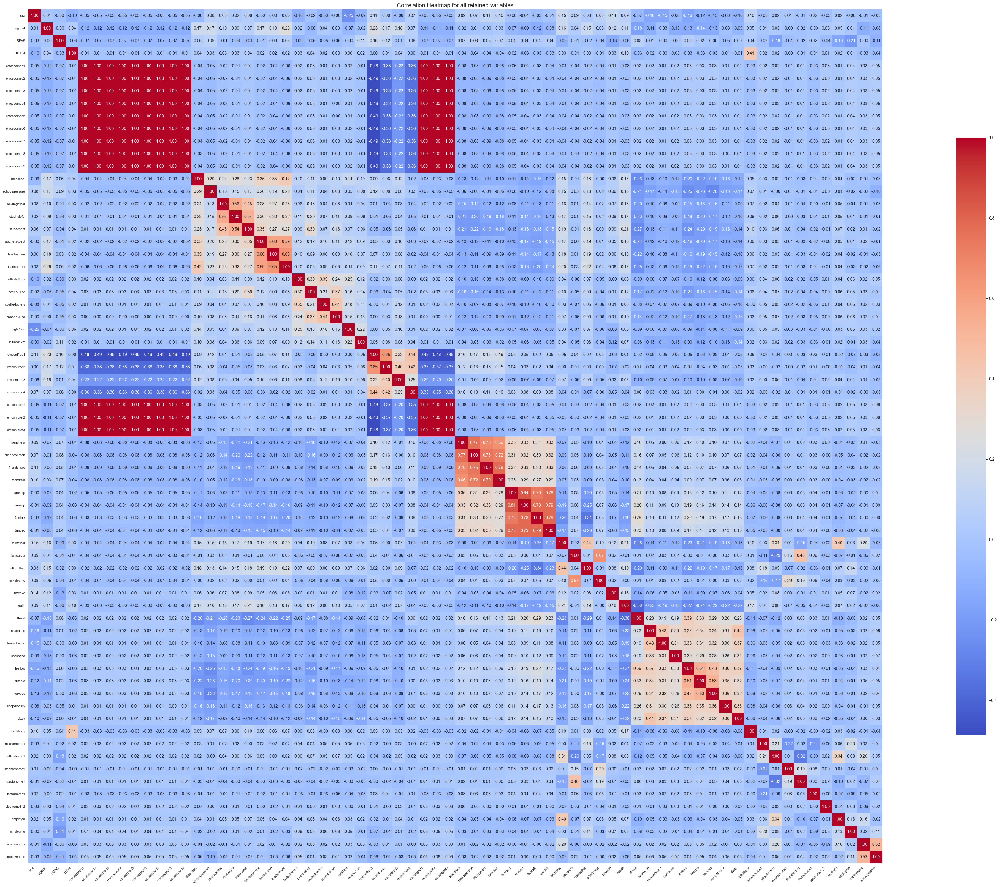

In [23]:
def plot_corr_all(df, plot_name):
    plt.clf()
    # Ensure the 'Plots' directory exists
    os.makedirs("Plots", exist_ok=True)


    corr = df.corr()
    plt.figure(figsize=(50, 30))  # Increase figure size

    sns.heatmap(
        corr,
        annot=True,
        cmap='coolwarm',
        fmt=".2f",
        square=True,
        annot_kws={"size": 10},  # Smaller annotation font
        cbar_kws={'shrink': 0.7}  # Shrink color bar
    )
    plt.title(f"Correlation Heatmap for all retained variables", fontsize=14)
    plt.xticks(rotation=45, ha='right', fontsize=8)  # Rotate x labels
    plt.yticks(rotation=0, fontsize=8)  # Rotate y labels
    plt.tight_layout()
    plt.savefig(f"Plots/Correlations_{plot_name}.png")
    plt.show()

retained_data = data[retain]
plot_corr_all(retained_data, "retained with nones")


In [24]:
print("Dataset size is ", data.shape)
print("Retaine dataset size is ", retained_data.shape)

Dataset size is  (244097, 120)
Retaine dataset size is  (244097, 68)


Найпростіший варіант це випилити усі які є з порожніми місцями. Те що інконсістент(-99 або 99) можна заповнити. Нам важливо запустити ПС для фічер селекшону

In [25]:
def pca_selected(df, cols_to_pc, new_col):
    data_array = df[cols_to_pc].to_numpy() ## CHANGE IT
    # Create PCA object with 1 component
    pca = PCA(n_components=1)

    # Fit PCA on the data
    pca.fit(data_array)

    # Transform the data (project onto the first principal component)
    data_transformed = pca.transform(data_array)

    # Print results
    print("Explained variance ratio:", pca.explained_variance_ratio_)
    print("Singular value:", pca.singular_values_)
    print("Total explained variance:", round(pca.explained_variance_ratio_.sum(), 5))

    df[new_col] = data_transformed
    df = df.drop(columns=cols_to_pc)
    return df

In [26]:
def pc_runner(df, citest = "chisq", alpha = 0.05, name = "test"):
    os.makedirs("Graphs", exist_ok=True)
    data_array = df.to_numpy()
    cg = pc(data_array,
            independence_test=citest,
            alpha=alpha, #significance level
            labels=df.columns)

    pyd = GraphUtils.to_pydot(cg.G, labels=df.columns)
    pyd.write_png(f'Graphs\PC_{citest}_alpha_{alpha}_{name}.png')

In [27]:
import os
import numpy as np
import pandas as pd
from causallearn.search.ConstraintBased.FCI import fci
from causallearn.utils.cit import fisherz, gsq, kci, chi2, mv_fisherz
from causallearn.utils.GraphUtils import GraphUtils

def run_fci(
    data: pd.DataFrame,
    test: str = "fisherz",
    alpha: float = 0.05,
    depth: int = -1,
    max_path_length: int = -1,
    output_dir: str = "graphs",
    run_name = "general"
) -> tuple:
    """
    Run FCI algorithm with specified parameters and save resulting PAG

    Parameters:
        data: Input dataframe with variables as columns
        test: Conditional independence test (fisherz/mv_fisherz/gsq/chi2/kci)
        alpha: Significance level (default: 0.05)
        depth: Search depth for adjacency (-1=unlimited)
        max_path_length: Max discriminating path length (-1=unlimited)
        output_dir: Output directory for graphs

    Returns:
        tuple: (graph, edges) from FCI results
    """
    os.makedirs(output_dir, exist_ok=True)
    data_array = data.values.astype(np.float32)

    test_map = {
        "fisherz": fisherz,
        "mv_fisherz": mv_fisherz,
        "gsq": gsq,
        "chi2": chi2,
        "kci": kci
    }

    if test not in test_map:
        raise ValueError(f"Invalid test {test}. Choose from {list(test_map.keys())}")

    # Run FCI with specified parameters
    graph, edges = fci(
        dataset=data_array,
        independence_test_method=test_map[test],
        alpha=alpha,
        depth=depth,
        max_path_length=max_path_length,
        verbose=True
    )

    # Generate visualization
    filename = f"fci_{test}_a{alpha}_d{depth}_m{max_path_length}_{run_name}.png"
    GraphUtils.to_pydot(graph, labels=data.columns.tolist()).write_png(
        os.path.join(output_dir, filename)
    )

    return graph, edges


In [28]:
# import numpy as np
# import os
# from causallearn.search.ConstraintBased.RFCI import rfci
# from causallearn.utils.cit import fisherz
# from causallearn.utils import GraphUtils
#
# def rfci_alternative(df, alpha=0.05, name="test"):
#     data_array = df.to_numpy().astype(np.float64)
#
#     # Run RFCI with Fisher's Z conditional independence test
#     result = rfci(data_array, fisherz, alpha=alpha)
#
#     # Get the learned PAG graph
#     graph = result.G
#     print(graph)
#
#     # Create directory if it doesn't exist
#     os.makedirs("Graphs", exist_ok=True)
#
#     # Draw and save the graph
#     GraphUtils.draw_pydot_graph(graph, labels=df.columns.tolist()).savefig(
#         f"Graphs/RFCI_alternative_alpha_{alpha}_{name}.png", bbox_inches='tight')
#
#     return graph


<Figure size 640x480 with 0 Axes>

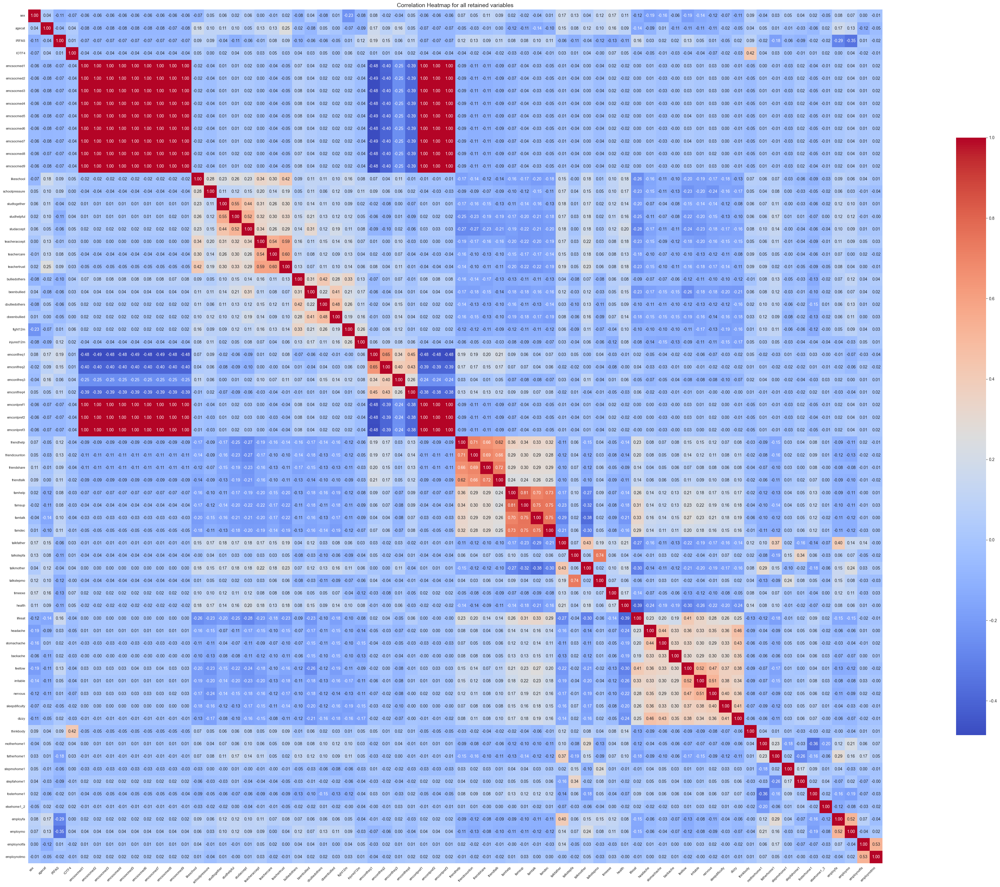

In [29]:
retained_data_nona = retained_data.dropna() #retained_data[(retained_data != 99).any(axis=1) | (retained_data != -99).any(axis=1)].dropna()
plot_corr_all(retained_data_nona, "retained without nones")

In [30]:
cols_to_pc = retain_dict["digital_communication"]
new_name = "pc_emcsocmed"
retained_data_nona = pca_selected(retained_data_nona, cols_to_pc, new_name)
retain_dict["digital_communication"] = new_name

Explained variance ratio: [0.99980996]
Singular value: [4358.97688002]
Total explained variance: 0.99981


C:\Users\dnedi\AppData\Local\Temp\ipykernel_35864\4244222104.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df[new_col] = data_transformed


In [31]:
retained_data_nona.columns

Index(['sex', 'agecat', 'IRFAS', 'IOTF4', 'likeschool', 'schoolpressure',
       'studtogether', 'studhelpful', 'studaccept', 'teacheraccept',
       'teachercare', 'teachertrust', 'bulliedothers', 'beenbullied',
       'cbulliedothers', 'cbeenbullied', 'fight12m', 'injured12m',
       'emconlfreq1', 'emconlfreq2', 'emconlfreq3', 'emconlfreq4',
       'emconlpref1', 'emconlpref2', 'emconlpref3', 'friendhelp',
       'friendcounton', 'friendshare', 'friendtalk', 'famhelp', 'famsup',
       'famtalk', 'famdec', 'talkfather', 'talkstepfa', 'talkmother',
       'talkstepmo', 'timeexe', 'health', 'lifesat', 'headache', 'stomachache',
       'backache', 'feellow', 'irritable', 'nervous', 'sleepdificulty',
       'dizzy', 'thinkbody', 'motherhome1', 'fatherhome1', 'stepmohome1',
       'stepfahome1', 'fosterhome1', 'elsehome1_2', 'employfa', 'employmo',
       'employnotfa', 'employnotmo', 'pc_emcsocmed'],
      dtype='object')

<Figure size 640x480 with 0 Axes>

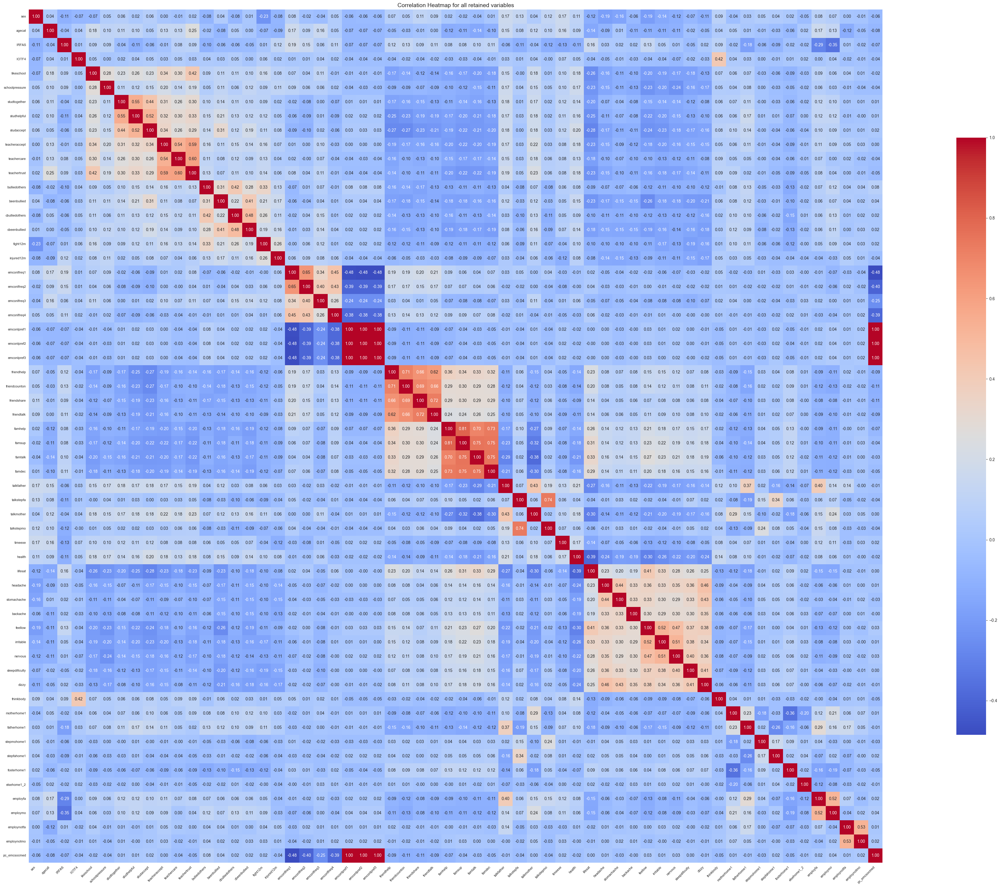

In [32]:
plot_corr_all(retained_data_nona, "pc for digital communication")

Explained variance ratio: [0.99948955]
Singular value: [2493.72504913]
Total explained variance: 0.99949


<Figure size 640x480 with 0 Axes>

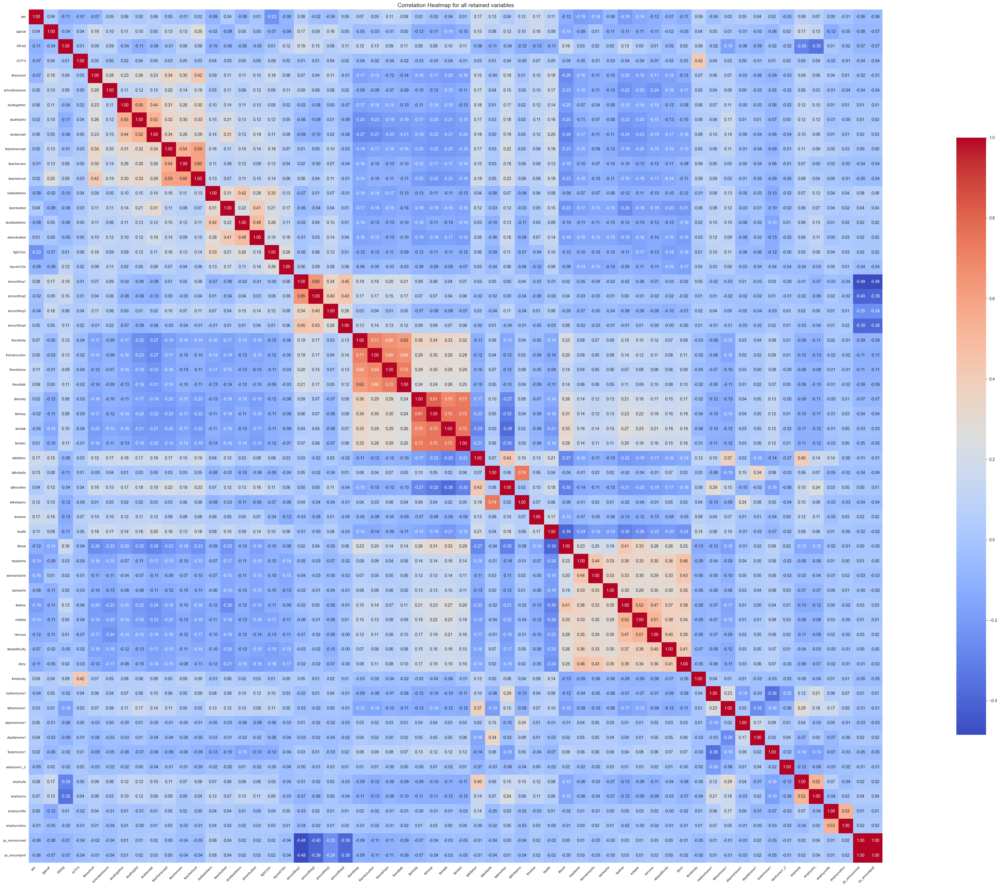

In [33]:
cols_to_pc = retain_dict["digital_contact_preference"]
new_name = "pc_emconlpref"
retained_data_nona = pca_selected(retained_data_nona, cols_to_pc, new_name)
retain_dict["digital_contact_preference"] = new_name
plot_corr_all(retained_data_nona, "pc for digital communication preferences")

Explained variance ratio: [0.57426963]
Singular value: [145.1094365]
Total explained variance: 0.57427


<Figure size 640x480 with 0 Axes>

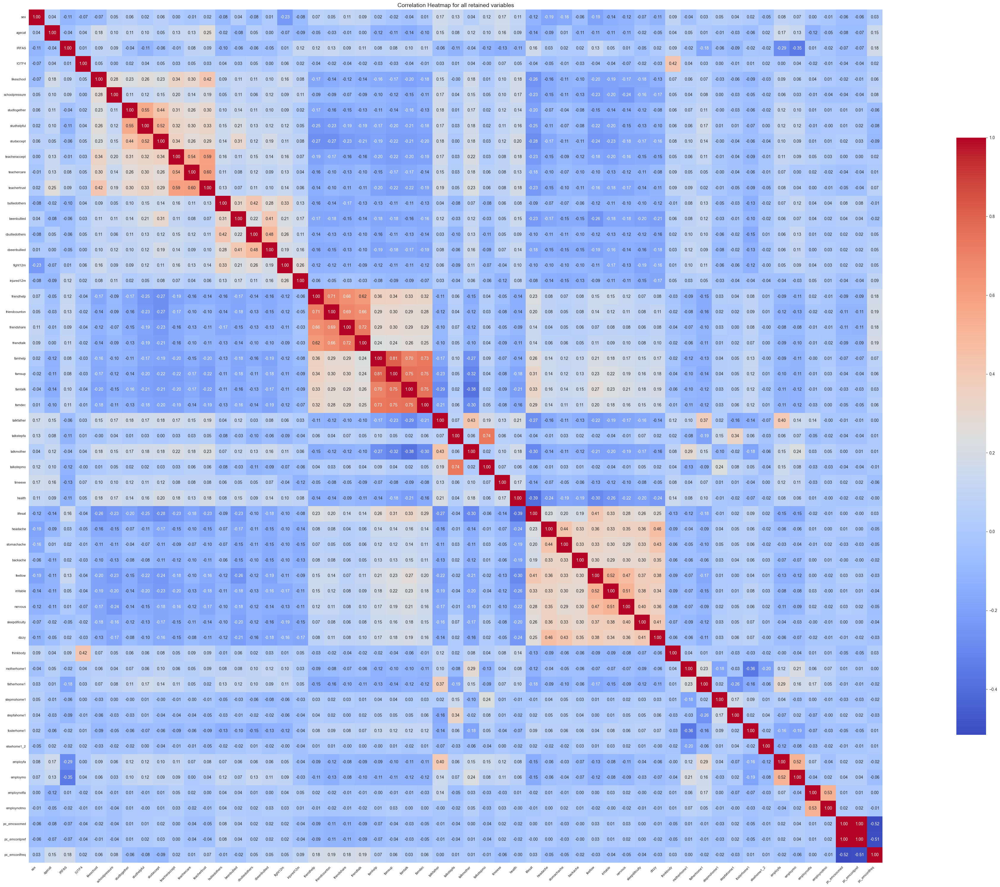

In [34]:
cols_to_pc = retain_dict["digital_contact_frequency"]
new_name = "pc_emconlfreq"
retained_data_nona = pca_selected(retained_data_nona, cols_to_pc, new_name)
retain_dict["digital_contact_frequency"] = new_name
plot_corr_all(retained_data_nona, "pc for digital all grouped")

In [35]:
retained_data_nona.shape

(3500, 55)

In [36]:
retained_data_nona.columns

Index(['sex', 'agecat', 'IRFAS', 'IOTF4', 'likeschool', 'schoolpressure',
       'studtogether', 'studhelpful', 'studaccept', 'teacheraccept',
       'teachercare', 'teachertrust', 'bulliedothers', 'beenbullied',
       'cbulliedothers', 'cbeenbullied', 'fight12m', 'injured12m',
       'friendhelp', 'friendcounton', 'friendshare', 'friendtalk', 'famhelp',
       'famsup', 'famtalk', 'famdec', 'talkfather', 'talkstepfa', 'talkmother',
       'talkstepmo', 'timeexe', 'health', 'lifesat', 'headache', 'stomachache',
       'backache', 'feellow', 'irritable', 'nervous', 'sleepdificulty',
       'dizzy', 'thinkbody', 'motherhome1', 'fatherhome1', 'stepmohome1',
       'stepfahome1', 'fosterhome1', 'elsehome1_2', 'employfa', 'employmo',
       'employnotfa', 'employnotmo', 'pc_emcsocmed', 'pc_emconlpref',
       'pc_emconlfreq'],
      dtype='object')

In [ ]:

#pc_runner(retained_data.drop(columns = retain_dict["demographics"]).dropna(), name= "all data no nans", citest = "gsq")
run_fci(retained_data_nona[retain_dict["school_environment"] +retain_dict["bullying_violence"]], run_name="school_env_bull")

run_fci(retained_data_nona[retain_dict["family_support"] + retain_dict["mom_support"]+retain_dict["father_support"] +
retain_dict["friend_support"]+retain_dict["bullying_violence"]], run_name="family_friend_par_supp_bull")

run_fci(retained_data_nona[retain_dict["family_structure"] + retain_dict["family_employment"]+retain_dict["family_affluence_indices"] + retain_dict["bullying_violence"]], run_name= "socio-econom_bull")

run_fci(retained_data_nona[retain_dict["mental_health"] + retain_dict["family_support"] +retain_dict["physical_health"]+retain_dict["bullying_violence"]+retain_dict["health_behaviors"]], run_name="health_bull")

  0%|          | 0/14 [00:00<?, ?it/s]

0 dep 1 | () with p-value 0.000000

0 dep 2 | () with p-value 0.000000

0 dep 3 | () with p-value 0.000000

0 dep 4 | () with p-value 0.000000

0 dep 5 | () with p-value 0.000000

0 dep 6 | () with p-value 0.000000

0 dep 7 | () with p-value 0.000000

0 dep 8 | () with p-value 0.000000

0 dep 9 | () with p-value 0.000000

0 dep 10 | () with p-value 0.000000

0 dep 11 | () with p-value 0.000000

0 dep 12 | () with p-value 0.000000

0 dep 13 | () with p-value 0.000001

1 dep 0 | () with p-value 0.000000

1 dep 2 | () with p-value 0.000000

1 dep 3 | () with p-value 0.000000

1 dep 4 | () with p-value 0.000000

1 dep 5 | () with p-value 0.000000

1 dep 6 | () with p-value 0.000000

1 dep 7 | () with p-value 0.000000

1 dep 8 | () with p-value 0.002055

1 dep 9 | () with p-value 0.000000

1 dep 10 | () with p-value 0.000208

1 dep 11 | () with p-value 0.000000

1 dep 12 | () with p-value 0.000000

1 dep 13 | () with p-value 0.000000

2 dep 0 | () with p-value 0.000000

2 dep 1 | () with p-

  0%|          | 0/18 [00:00<?, ?it/s]

0 dep 1 | () with p-value 0.000000

0 dep 2 | () with p-value 0.000000

0 dep 3 | () with p-value 0.000000

0 dep 4 | () with p-value 0.000000

0 dep 5 | () with p-value 0.000000

0 dep 6 | () with p-value 0.000000

0 dep 7 | () with p-value 0.000000

0 dep 8 | () with p-value 0.000000

0 dep 9 | () with p-value 0.000000

0 dep 10 | () with p-value 0.000000

0 dep 11 | () with p-value 0.000000

0 dep 12 | () with p-value 0.000000

0 dep 13 | () with p-value 0.000000

0 dep 14 | () with p-value 0.000000

0 dep 15 | () with p-value 0.000000

0 dep 16 | () with p-value 0.000000

0 dep 17 | () with p-value 0.000006

1 dep 0 | () with p-value 0.000000

1 dep 2 | () with p-value 0.000000

1 dep 3 | () with p-value 0.000000

1 dep 4 | () with p-value 0.000000

1 dep 5 | () with p-value 0.035392

1 dep 6 | () with p-value 0.000000

1 dep 7 | () with p-value 0.003324

1 dep 8 | () with p-value 0.000000

1 dep 9 | () with p-value 0.000000

1 dep 10 | () with p-value 0.000000

1 dep 11 | () with 

  0%|          | 0/17 [00:00<?, ?it/s]

0 dep 1 | () with p-value 0.000000

0 dep 2 | () with p-value 0.000000

0 ind 3 | () with p-value 0.096520

0 dep 4 | () with p-value 0.000000

0 dep 5 | () with p-value 0.000000

0 dep 6 | () with p-value 0.000000

0 dep 7 | () with p-value 0.000000

0 dep 8 | () with p-value 0.000382

0 dep 9 | () with p-value 0.000027

0 ind 10 | () with p-value 0.236101

0 dep 11 | () with p-value 0.000002

0 dep 12 | () with p-value 0.000001

0 dep 13 | () with p-value 0.000000

0 dep 14 | () with p-value 0.000000

0 dep 15 | () with p-value 0.000000

0 dep 16 | () with p-value 0.043084

1 dep 0 | () with p-value 0.000000

1 ind 2 | () with p-value 0.337217

1 dep 3 | () with p-value 0.000000

1 dep 4 | () with p-value 0.000000

1 dep 5 | () with p-value 0.000206

1 dep 6 | () with p-value 0.000000

1 dep 7 | () with p-value 0.000000

1 dep 8 | () with p-value 0.000000

1 dep 9 | () with p-value 0.001142

1 dep 10 | () with p-value 0.000000

1 dep 11 | () with p-value 0.000000

1 dep 12 | () with 

  0%|          | 0/22 [00:00<?, ?it/s]

0 dep 1 | () with p-value 0.000000

0 dep 2 | () with p-value 0.000000

0 dep 3 | () with p-value 0.000000

0 dep 4 | () with p-value 0.000000

0 dep 5 | () with p-value 0.000000

0 dep 6 | () with p-value 0.000000

0 dep 7 | () with p-value 0.000000

0 dep 8 | () with p-value 0.000000

0 dep 9 | () with p-value 0.000000

0 dep 10 | () with p-value 0.000000

0 dep 11 | () with p-value 0.000000

0 dep 12 | () with p-value 0.000000

0 dep 13 | () with p-value 0.000000

0 dep 14 | () with p-value 0.000000

0 dep 15 | () with p-value 0.000000

0 dep 16 | () with p-value 0.000000

0 dep 17 | () with p-value 0.000000

0 dep 18 | () with p-value 0.000000

0 dep 19 | () with p-value 0.000000

0 dep 20 | () with p-value 0.000002

0 dep 21 | () with p-value 0.000000

1 dep 0 | () with p-value 0.000000

1 dep 2 | () with p-value 0.000000

1 dep 3 | () with p-value 0.000000

1 dep 4 | () with p-value 0.000000

1 dep 5 | () with p-value 0.000000

1 dep 6 | () with p-value 0.000000

1 dep 7 | () wit

In [ ]:
import os
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from cdt.causality.graph import CGNN

def cgnn_runner(df,
                nh=20,
                nruns=16,
                njobs=1,
                gpus=True,
                batch_size=-1,
                lr=0.01,
                train_epochs=1000,
                test_epochs=1000,
                verbose=True,
                dataloader_workers=0,
                name="test"):
    """
    Run CGNN for causal discovery (continuous data only).

    Parameters:
    - df: pandas DataFrame with continuous input features.
    - All other params: as defined in CGNN docs.
    - name: for saving output.
    """

    os.makedirs("Graphs", exist_ok=True)
    data = df.copy()

    # Convert object/category columns to numeric codes
    for col in data.select_dtypes(include=["object", "category"]).columns:
        data[col] = data[col].astype("category").cat.codes

    # Ensure all columns are numeric
    if not all(data.dtypes.apply(pd.api.types.is_numeric_dtype)):
        raise ValueError("All columns must be numeric (continuous) for CGNN.")

    # Ensure no missing values
    if data.isnull().values.any():
        raise ValueError("Data contains missing values. Please clean it first.")

    # Initialize CGNN
    model = CGNN(nh=nh,
                 nruns=nruns,
                 njobs=njobs,
                 gpus=gpus,
                 batch_size=batch_size,
                 lr=lr,
                 train_epochs=train_epochs,
                 test_epochs=test_epochs,
                 verbose=verbose,
                 dataloader_workers=dataloader_workers)

    # Run CGNN to get predicted causal graph
    output_graph = model.predict(data)

    # Visualization
    plt.figure(figsize=(8, 6))
    nx.draw_networkx(output_graph,
                     labels={i: col for i, col in enumerate(df.columns)},
                     arrows=True,
                     arrowsize=20,
                     node_size=1000)
    plt.title("CGNN Discovered Causal Graph")
    plt.savefig(f"Graphs/CGNN_{name}.png", bbox_inches='tight')
    plt.close()

    return output_graph


In [ ]:
import os
from castle.algorithms import FCI
import matplotlib.pyplot as plt
import seaborn as sns

def fci_runner_gcastle(df, alpha=0.05, name="test"):
    os.makedirs("Graphs", exist_ok=True)
    data_array = df.to_numpy()
    model = FCI()
    model.learn(data_array)
    # Visualization (adjacency matrix)

    plt.figure(figsize=(8, 6))
    sns.heatmap(model.causal_matrix, annot=True, cmap="coolwarm")
    plt.title("FCI Adjacency Matrix")
    plt.savefig(f"Graphs/FCI_gcastle_alpha_{alpha}_{name}.png")
    plt.close()
    return model.causal_matrix

fci_runner_gcastle(retained_data_nona.drop(columns = retain_dict["demographics"]))

In [ ]:
import sys
print(sys.maxsize > 2**32)import sys
print(sys.maxsize > 2**32)
import sys
print(sys.maxsize > 2**32)



In [ ]:
import os
os.environ["R_HOME"] = r"C:\\Program Files\\R\\R-4.5.0"  # Replace with your R path
os.environ["PATH"] += os.pathsep + r"C:\\Program Files\\R\\R-4.5.0\\bin\\x64"

# Now import rpy2
import rpy2.robjects as ro
from rpy2.robjects.packages import importr
import rpy2.situation
for row in rpy2.situation.iter_info():
    print(row)


In [ ]:
import rpy2.robjects as ro
from rpy2.robjects.packages import importr

utils = importr('utils')
utils.install_packages('dcFCI')


In [ ]:
import rpy2.robjects as ro
from rpy2.robjects.packages import importr

# Install devtools if not already installed
utils = importr('utils')
utils.install_packages('devtools')

# Now install dcFCI from GitHub
ro.r('devtools::install_github("mihaiconstantin/DC-FCI")')


In [ ]:
import rpy2.robjects as ro
from rpy2.robjects.packages import importr

# Install dcFCI in R first
name = "only drop none"
dcfci = importr("dcFCI")
result = dcfci.dcFCI(data=retained_data_nona)


In [ ]:
print(os.environ["PATH"])

In [ ]:

for col in retained_data_nona:
    print(col.unique)


### Почистити колонки - менше фічерс. Групувати ті, які одної категорії

# + OLD Chunks

In [ ]:
ukraine = 804000
denmark = 208000

In [ ]:
data_country = data[(data["countryno"] == ukraine) | (data["countryno"] == denmark)]

In [ ]:
print("Data sample for Ukraine is",data_country.shape)

In [ ]:
agesex = data_country[["agesex", "region"]]

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Prepare the data
stats_uadk = agesex.dropna().groupby(by="region")["agesex"]
stats_uadk_counts = stats_uadk.value_counts().reset_index(name="count")
stats_uadk_counts.columns = ["region", "agesex", "count"]

# Inner ring: total count by region
inner_data = stats_uadk_counts.groupby("region")["count"].sum()
inner_labels = inner_data.index
inner_sizes = inner_data.values

# Outer ring: counts of agesex within each region
outer_labels = stats_uadk_counts.apply(lambda row: f"{row['agesex']} ({row['region']})", axis=1)
outer_sizes = stats_uadk_counts["count"].values

# Define colors
inner_colors = plt.cm.tab20c.colors[:len(inner_labels)]
outer_colors = plt.cm.tab20.colors[:len(outer_labels)]

# Custom autopct to display both count and percent
def make_autopct(values):
    def autopct(pct):
        total = sum(values)
        val = int(round(pct * total / 100.0))
        return f"{pct:.1f}%\n({val})"
    return autopct

# Plot
fig, ax = plt.subplots(figsize=(12, 12))

# Inner pie (region)
wedges1, texts1, autotexts1 = ax.pie(
    inner_sizes, labels=inner_labels, radius=1, colors=inner_colors,
    autopct=make_autopct(inner_sizes), pctdistance=0.7,
    wedgeprops=dict(width=0.3, edgecolor='white')
)

# Outer pie (agesex within each region)
wedges2, texts2, autotexts2 = ax.pie(
    outer_sizes, labels=outer_labels, radius=1.3, colors=outer_colors,
    autopct=make_autopct(outer_sizes), pctdistance=0.85,
    wedgeprops=dict(width=0.3, edgecolor='white')
)

# Beautify text
for text in autotexts1 + autotexts2:
    text.set_color('black')
    text.set_fontsize(9)

ax.set(aspect="equal", title="Nested Pie Chart: Region (Inner) and AgeSex (Outer) with Percentages and Counts")
plt.tight_layout()
plt.show()


In [ ]:
data_ukraine = data[data["countryno"] == ukraine][["agesex", "region"]]
data_ukraine_counts = data_ukraine.value_counts().reset_index(name="count")
labels = data_ukraine_counts["agesex"]
plt.pie(data_ukraine_counts["count"], labels=labels)
plt.show()

In [ ]:
data_ukraine_counts

In [ ]:
# Select relevant variables for causal discovery
selected_columns = [
    "lifesat",
    "talkfather",
    "talkstepfa",
    "talkmother",
    "talkstepmo",
    "sex",
    "friendhelp",
    "friendcounton",
    "friendshare",
    "friendtalk"
]

df = data[selected_columns].copy()

# Drop rows with missing values
df = df.dropna()

# Optional: convert to numeric if not already
for col in selected_columns:
    df[col] = pd.to_numeric(df[col], errors='coerce')


In [ ]:
from sklearn.preprocessing import LabelEncoder

# Encode all variables as integers if not already
le_dict = {}
for col in df.columns:
    le = LabelEncoder()
    df[col] = le.fit_transform(df[col])
    le_dict[col] = le

In [ ]:
import numpy as np

# Convert DataFrame to NumPy array
data_array = df.to_numpy()

# Run PC algorithm with chi-square independence test for categorical data
cg = pc(data_array,
        independence_test='chi_square',
        alpha=0.05,
        labels=selected_columns)

pyd = GraphUtils.to_pydot(cg.G, labels=selected_columns)
pyd.write_png('simple_test.png')
plt.show()

In [ ]:

# Convert to numpy
data_np = df.to_numpy()

# FCI search (with Fisher Z-test and alpha = 0.05)
g, edges = fci(data_np,
         test_method="fisherz",
         alpha=0.05,
         verbose=True)

# Show graph
GraphUtils.to_pydot(g, labels=selected_columns).write_png("fci_result.png")

In [ ]:
general_info = ["region","id1", "id2", "id3", "id4", "adm", "month", "age", "sex", "grade" ]

abuse_cycle = ['lifesat',
               'irritable',
               'nervous',
               'fmeal',
               'timeexe',
               'friendhelp',
               'friendcounton',
               'friendshare',
               'friendtalk',
               'likeschool',
               'schoolpressure',
               'studtogether',
               'studhelpful',
               'studaccept',
               'teacheraccept',
               'teachercare',
               'teachertrust',
               'bulliedothers',
               'beenbullied',
               'cbulliedothers',
               'cbeenbullied',
               'fight12m',
               'injured12m',
               'emconlfreq1',
               'emconlfreq2',
               'emconlfreq3',
               'emconlfreq4',
               'emconlpref1',
               'emconlpref2',
               'emconlpref3',
               'emcsocmed1',
               'emcsocmed2',
               'emcsocmed3',
               'emcsocmed4',
               'emcsocmed5',
               'emcsocmed6',
               'emcsocmed7',
               'emcsocmed8',
               'emcsocmed9',
               'motherhome1',
               'fatherhome1',
               'stepmohome1',
               'stepfahome1',
               'fosterhome1',
               'elsehome1_2',
               'employfa',
               'employmo',
               'employnotfa',
               'employnotmo',
               'talkfather',
               'talkstepfa',
               'talkmother',
               'talkstepmo',
               'famhelp',
               'famsup',
               'famtalk',
               'famdec',
               'MBMI',
               'IRFAS',
               'IRRELFAS_LMH'
               ]

#influence of social factors on aggression levels

In [ ]:
var = abuse_cycle + general_info
aggression_data = data[var]

In [ ]:
description = aggression_data.describe()

In [ ]:
aggression_data.info()

In [ ]:
empties = aggression_data.isna().sum()

In [ ]:
empties = pd.DataFrame(empties, columns = ["nulls"])
empties = empties.transpose()


In [ ]:
stats = pd.concat([description, empties])
t4 = stats.transpose()
t4 = t4.dropna().round(3)
t4[["count", "nulls"]] = t4[["count", "nulls"]].astype("int")
t4

In [ ]:

with open("latex_chunks.txt", "w") as my_file:
    my_file.write(t4.to_latex())


In [ ]:
aggression_data.info()

In [ ]:
# Set Seaborn style for nicer plots
sns.set(style="whitegrid")

# Plot a histogram for each variable
for column in aggression_data.columns:
    plt.figure(figsize=(6, 4))
    sns.histplot(aggression_data[column].dropna(), kde=True, bins=30)
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.show()


In [ ]:
pd.DataFrame(data.columns).to_csv("columns of data.csv")


In [ ]:
hbsc_bullying_vars = {
    "aggression": [
        "beenbullied",        # Been bullied at school
        "bulliedothers",      # Bullying others at school
        "cbeenbullied",       # Been cyberbullied
        "cbulliedothers",     # Cyber bullied others
        "fight12m"            # Times in physical fight past 12 months
    ],
    "demographics": [ #use for missing data handling
        "age",
        "agecat", #the same but discrete
        "sex",
        "grade"
    ],
    "socioeconom_fas3": [
        "fasfamcar",          # Family car
        "fasbedroom",         # Own bedroom
        "fascomputers",       # Number of computers
        "fasbathroom",        # Number of bathrooms
        "fasdishwash",        # Dishwasher in home
        "fasholidays"         # Family holidays abroad last year
    ],
    "health": [
        "health",             # Self-rated health
        "lifesat",            # Life satisfaction
        "headache",
        "stomachache",
        "backache",
        "feellow",            # Feeling low
        "irritable",
        "nervous",
        "sleepdificulty",
        "dizzy"
    ],
    "bodyimage": [
        "thinkbody",          # Perception of own body
        "bodyweight",         # Weight
        "bodyheight"          # Height
    ],
    "family": [
        "motherhome1",        # Mother in main home
        "fatherhome1",        # Father in main home
        "stepmohome1",        # Stepmother in main home
        "stepfahome1",        # Stepfather in main home
        "fosterhome1",        # Foster/child home
        "elsehome1_2",        # Living with someone else
        "employfa",           # Father's employment
        "employmo",           # Mother's employment
        "talkfather",         # Talk to father
        "talkmother",         # Talk to mother
        "talkstepfa",         # Talk to stepfather
        "talkstepmo"          # Talk to stepmother
    ],
    "school": [
        "likeschool",         # Liking school
        "schoolpressure",     # Pressured by schoolwork
        "studtogether",       # Students enjoy being together
        "studhelpful",        # Students kind and helpful
        "studaccept",         # Students accept me
        'teacheraccept',      # Teacher accepts me
        'teachercare',        # Teacher cares about me
        'teachertrust',       # Trust in teacher
    ],
    "friends": [
        "friendhelp",         # Friends try to help
        "friendcounton",      # Can count on friends
        "friendshare",        # Friends to share joys with
        "friendtalk"          # Can talk about problems with friends
    ],
    "SoMe_med": [
        "emcsocmed1",         # Social media: can't think of anything else
        "emcsocmed2",         # Social media: want to spend more time
        "emcsocmed3",         # Social media: felt bad when couldn't use
        "emcsocmed4",         # Social media: failed to spend less time
        "emcsocmed5",         # Social media: neglected other activities
        "emcsocmed6",         # Social media: arguments because of use
        "emcsocmed7",         # Social media: lied about amount
        "emcsocmed8",         # Social media: escape from negative feelings
        "emcsocmed9"          # Social media: conflict with family
    ],
    "SoMe_freq": [
        "emconlfreq1",        # Online contact with close friends
        "emconlfreq2",        # Online contact with larger friend group
        "emconlfreq3",        # Online contact with online friends
        "emconlfreq4",        # Online contact with others
    ],
    "habits": [
        "physact60",          # Physical activity past 7 days
        "timeexe",            # Vigorous physical activity frequency
        "breakfastwd",        # Breakfast weekdays
        "breakfastwe",        # Breakfast weekends
        "fruits_2",           # Eat fruits
        "vegetables_2",       # Eat vegetables
        "sweets_2",           # Eat sweets
        "softdrinks_2",       # Drink soft drinks
        "smokltm",            # Days smoked in lifetime
        "smok30d_2",          # Days smoked last 30 days
        "alcltm",             # Alcohol use in lifetime
        "alc30d_2",           # Alcohol use last 30 days
        "drunkltm",           # Drunkenness lifetime
        "drunk30d",           # Drunkenness last 30 days
        "cannabisltm_2",      # Cannabis use lifetime
        "cannabis30d_2"        # Cannabis use last 30 days
    ],
    "origin": [
        "countrybornmo",      # Mother's country of birth
        "countrybornfa"       # Father's country of birth
    ]
}


In [ ]:
hbsc_bullying_vars.keys()

In [ ]:
retained_data[retained_data.isnull().any(axis=1)]

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import os

# Ensure the 'Plots' directory exists
os.makedirs("Plots", exist_ok=True)
for key in retain_dict.keys():
    temp_data = data[retain_dict[key]]
    print(f"Plots for {key}")

    # Histogram
    temp_data.hist(figsize=(10, 10))
    plt.tight_layout()
    plt.savefig(f"Plots/Hist_{key}.png")
    #plt.show()

    subval = retain_dict[key] + retain_dict["bullying_violence"]
    retained_data = data[subval]
    corr = retained_data.corr()
    if len(subval)>10:
        plt.figure(figsize=(16, 14))  # Increase figure size

        sns.heatmap(
            corr,
            annot=True,
            cmap='coolwarm',
            fmt=".2f",
            square=True,
            annot_kws={"size": 10},  # Smaller annotation font
            cbar_kws={'shrink': 0.7}  # Shrink color bar
        )


    else:
        plt.figure(figsize=(10, 8))
        sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", square=True)
        # plt.title(f"Correlation Heatmap for {key}")
        # plt.figure(figsize=(10, 8))
        # # plt.tight_layout()
        # plt.savefig(f"Plots/Correlations_{key}.png")
        # plt.show()
    plt.title(f"Correlation Heatmap for {key}", fontsize=14)
    plt.xticks(rotation=45, ha='right', fontsize=8)  # Rotate x labels
    plt.yticks(rotation=0, fontsize=8)  # Rotate y labels
    plt.tight_layout()
    plt.savefig(f"Plots/Correlations_{key}.png")
    #plt.show()


In [ ]:
data_not_null = data[data.notna().any(axis=1)]
missing_not_at_random_dropped = data_not_null[(data_not_null == 99).any(axis=1) | (data_not_null == -99).any(axis=1)]



In [ ]:
rows_with_nans = data[data.isnull().any(axis=1)]
rows_with_nans

In [ ]:
data_incons = data[(data == 99).any(axis=1) | (data == -99).any(axis=1)]
print(data_incons.shape)
incons_notnans = data_incons.dropna()
print(incons_notnans.shape)
incons_notnans

In [ ]:
hbsc_groups = {
    "administrative_identifiers": [
        "seqno_int", "cluster", "countryno", "region", "id1", "id2", "id3", "id4", "adm", "month", "year", "weight"
    ],
    "demographics": [
        "age", "agecat", "sex", "grade", "monthbirth", "yearbirth", "countryborn", "countrybornmo", "countrybornfa"
    ],
    "family_affluence_fas": [
        "fasfamcar", "fasbedroom", "fascomputers", "fasbathroom", "fasdishwash", "fasholidays", "IRFAS", "IRRELFAS_LMH"
    ],
    "health_behaviors": [
        "physact60", "breakfastwd", "breakfastwe", "fruits_2", "vegetables_2", "sweets_2", "softdrinks_2",
        "fmeal", "toothbr", "timeexe"
    ],
    "mental_physical_health": [
        "health", "lifesat", "headache", "stomachache", "backache", "feellow", "irritable", "nervous",
        "sleepdificulty", "dizzy", "thinkbody"
    ],
    "substance_use": [
        "smokltm", "smok30d_2", "alcltm", "alc30d_2", "drunkltm", "drunk30d", "cannabisltm_2", "cannabis30d_2"
    ],
    "school_environment_peer_relations": [
        "likeschool", "schoolpressure", "studtogether", "studhelpful", "studaccept",
        "teacheraccept", "teachercare", "teachertrust"
    ],
    "bullying_violence": [
        "bulliedothers", "beenbullied", "cbulliedothers", "cbeenbullied", "fight12m", "injured12m"
    ],
    "social_support_communication": [
        "friendhelp", "friendcounton", "friendshare", "friendtalk", "famhelp", "famsup", "famtalk", "famdec",
        "talkfather", "talkstepfa", "talkmother", "talkstepmo"
    ],
    "digital_communication_freqperf": [
        "emconlfreq1", "emconlfreq2", "emconlfreq3", "emconlfreq4",
        "emconlpref1", "emconlpref2", "emconlpref3"
    ],
    "digital_communication_med": [
        "emcsocmed1", "emcsocmed2", "emcsocmed3", "emcsocmed4", "emcsocmed5", "emcsocmed6", "emcsocmed7", "emcsocmed8", "emcsocmed9"
    ],
    "sexual_health": [
        "hadsex", "agesex", "contraceptcondom", "contraceptpill"
    ],
    "family_structure_employment": [
        "motherhome1", "fatherhome1", "stepmohome1", "stepfahome1", "fosterhome1", "elsehome1_2",
        "employfa", "employmo", "employnotfa", "employnotmo"
    ],
    "anthropometric_data": [
        "bodyweight", "bodyheight", "MBMI", "IOTF4", "oweight_who"
    ],
    "derived_indices": [
        "IRFAS", "IRRELFAS_LMH", "IOTF4"
    ]
}
